## ENVIRONMENT SETUP AND GLOBAL CONFIGURATIONS

IN THIS SECTION, WE IMPORT ALL REQUIRED LIBRARIES AND SET THE GLOBAL VISUALIZATION STANDARDS TO ENSURE PUBLICATION-QUALITY PLOTS. EVERY PLOT WILL ADHERE TO THE SPECIFIED `FIGSIZE=(8, 6)`, `DPI=500`, WITH BOLD TEXT AND UPPERCASE LABELS.

In [10]:
# IMPORT CORE LIBRARIES FOR DATA MANIPULATION AND MATHEMATICS
import numpy as np
import pandas as pd

# IMPORT VISUALIZATION LIBRARIES
import matplotlib.pyplot as plt
import seaborn as sns

In [11]:
# SET GLOBAL PLOTTING STANDARDS FOR AESTHETIC AND PROFESSIONAL VISUALS
plt_config = {
    'figure.figsize': (8, 6),
    'figure.dpi': 500,
    'axes.grid': True,
    'font.weight': 'bold',
    'axes.labelweight': 'bold',
    'axes.titleweight': 'bold',
    'xtick.labelsize': 'medium',
    'ytick.labelsize': 'medium',
    'axes.labelsize': 'large',
    'axes.titlesize': 'x-large'
}
plt.rcParams.update(plt_config)

def format_plot_axes(ax, title, xlabel, ylabel):
    """
    FORMATS THE AXES OF A PLOT TO ENSURE ALL TEXT IS UPPERCASE AND BOLD.
    
    PARAMETERS:
    AX (MATPLOTLIB.AXES): THE AXIS OBJECT TO FORMAT.
    TITLE (STR): THE TITLE OF THE PLOT.
    XLABEL (STR): THE X-AXIS LABEL.
    YLABEL (STR): THE Y-AXIS LABEL.
    """
    ax.set_title(title.upper(), fontweight='bold')
    ax.set_xlabel(xlabel.upper(), fontweight='bold')
    ax.set_ylabel(ylabel.upper(), fontweight='bold')
    
    # ENFORCE BOLD TICK LABELS
    for tick in ax.get_xticklabels():
        tick.set_fontweight('bold')
    for tick in ax.get_yticklabels():
        tick.set_fontweight('bold')

## DATA GENERATION AND VALIDATION
WE GENERATE A SYNTHETIC DATASET OF 10,000 SAMPLES BASED ON THE EXPERIMENTAL RANGES AND THEORETICAL PRINCIPLES[cite: 505]. THE AC CONDUCTIVITY TARGET VARIABLE IS CALCULATED USING THE PHYSICAL RELATION:

$ \sigma_{ac} = \epsilon_0 \cdot \epsilon_r \cdot \omega \cdot \tan(\delta) $

WHERE:

- $\epsilon_0 = 8.854 \times 10^{-12}$ F/M (PERMITTIVITY OF FREE SPACE) 
- $\epsilon_r$ IS THE DIELECTRIC CONSTANT 
- $\omega = 2 \pi f$ (ANGULAR FREQUENCY) 
- $\tan(\delta) = 0.01$ (LOSS TANGENT, ASSUMED CONSTANT) 

In [12]:
def generate_tlinte2_data(n_samples=10000):
    """
    GENERATES A SYNTHETIC DATASET FOR TLINTE2 AC CONDUCTIVITY PREDICTION 
    BASED ON DEFINED PHYSICAL PARAMETER RANGES.
    
    RETURNS:
    PD.DATAFRAME: THE GENERATED DATASET.
    """
    # SET RANDOM SEED FOR REPRODUCIBILITY
    np.random.seed(42)
    
    # GENERATE INDEPENDENT VARIABLES USING UNIFORM DISTRIBUTIONS
    temperature = np.random.uniform(150, 600, n_samples)
    frequency = np.random.uniform(1e6, 5e6, n_samples)
    crystallite_size = np.random.uniform(40, 80, n_samples)
    dislocation_density = np.random.uniform(1e14, 3e14, n_samples)
    micro_strain = np.random.uniform(0.001, 0.003, n_samples)
    dielectric_constant = np.random.uniform(0.85, 6.0, n_samples)
    
    # PHYSICAL CONSTANTS
    epsilon_0 = 8.854e-12  # PERMITTIVITY OF FREE SPACE (F/M)
    tan_delta = 0.01       # LOSS TANGENT
    
    # CALCULATE ANGULAR FREQUENCY (OMEGA)
    omega = 2 * np.pi * frequency
    
    # CALCULATE AC CONDUCTIVITY (TARGET VARIABLE)
    ac_conductivity = epsilon_0 * dielectric_constant * omega * tan_delta
    
    # CREATE DATAFRAME
    df = pd.DataFrame({
        'temperature_k': temperature,
        'frequency_hz': frequency,
        'crystallite_size_nm': crystallite_size,
        'dislocation_density_1_m2': dislocation_density,
        'micro_strain': micro_strain,
        'dielectric_constant': dielectric_constant,
        'ac_conductivity_s_m': ac_conductivity
    })
    
    return df

# GENERATE DATASET
df_tlinte2 = generate_tlinte2_data(10000)

# VERIFY DISTRIBUTION RANGES AND DISPLAY SUMMARY STATISTICS
print("### DATASET SUMMARY STATISTICS ###\n")
print(df_tlinte2.describe().T.to_string())

### DATASET SUMMARY STATISTICS ###

                            count          mean           std           min           25%           50%           75%           max
temperature_k             10000.0  3.723718e+02  1.294336e+02  1.500052e+02  2.608480e+02  3.716379e+02  4.830029e+02  5.998730e+02
frequency_hz              10000.0  3.018120e+06  1.157178e+06  1.000631e+06  2.015783e+06  3.023587e+06  4.025917e+06  4.999699e+06
crystallite_size_nm       10000.0  6.000202e+01  1.147095e+01  4.000192e+01  5.014992e+01  6.008272e+01  6.978695e+01  7.999604e+01
dislocation_density_1_m2  10000.0  1.997427e+14  5.779892e+13  1.000011e+14  1.493714e+14  2.000060e+14  2.494233e+14  2.999579e+14
micro_strain              10000.0  1.993728e-03  5.785684e-04  1.000033e-03  1.488544e-03  1.987434e-03  2.500954e-03  2.999944e-03
dielectric_constant       10000.0  3.441195e+00  1.484958e+00  8.500434e-01  2.173326e+00  3.456366e+00  4.730247e+00  5.999689e+00
ac_conductivity_s_m       10000.0  5.782

## EXTENSIVE EXPLORATORY DATA ANALYSIS (EDA)

BEFORE TRAINING ANY MODELS, IT IS CRITICAL TO VISUALLY AND STATISTICALLY ANALYZE THE GENERATED DATASET. WE WILL EXAMINE HISTOGRAMS, KDE DISTRIBUTIONS, AND FEATURE INTERACTIONS TO UNDERSTAND THE MATHEMATICAL DEPENDENCIES, PARTICULARLY FOCUSING ON TEMPERATURE, FREQUENCY, AND DIELECTRIC CONSTANT AGAINST THE AC CONDUCTIVITY.

### HISTOGRAM KDE

In [15]:
def plot_histograms_kde(df):
    """
    PLOTS HISTOGRAMS WITH KDE (KERNEL DENSITY ESTIMATION) FOR ALL VARIABLES.
    """
    cols = df.columns
    fig, axes = plt.subplots(3, 3, figsize=(24, 18), dpi=500)
    axes = axes.flatten()
    
    for i, col in enumerate(cols):
        sns.histplot(df[col], kde=True, ax=axes[i], color='steelblue', edgecolor='black')
        format_plot_axes(axes[i], title=f"DISTRIBUTION OF {col}", xlabel=col, ylabel="COUNT")
        
    # HIDE UNUSED SUBPLOTS
    for j in range(len(cols), len(axes)):
        fig.delaxes(axes[j])
        
    plt.tight_layout()
    plt.show()

In [16]:
plot_histograms_kde(df_tlinte2)

### CORRELATION HEATMAP

In [17]:
def plot_correlation_heatmap(df):
    """
    COMPUTES AND VISUALIZES THE PEARSON CORRELATION MATRIX USING A HEATMAP.
    """
    fig, ax = plt.subplots(figsize=(10, 8), dpi=500)
    corr_matrix = df.corr(method='pearson')
    
    # PLOT HEATMAP
    sns.heatmap(corr_matrix, annot=True, fmt=".3f", cmap='coolwarm', 
                square=True, linewidths=1, linecolor='black', ax=ax, 
                annot_kws={'weight': 'bold', 'size': 10})
    
    format_plot_axes(ax, title="PEARSON CORRELATION HEATMAP", xlabel="", ylabel="")
    plt.xticks(rotation=45, ha='right', fontweight='bold')
    plt.yticks(rotation=0, fontweight='bold')
    
    plt.tight_layout()
    plt.show()

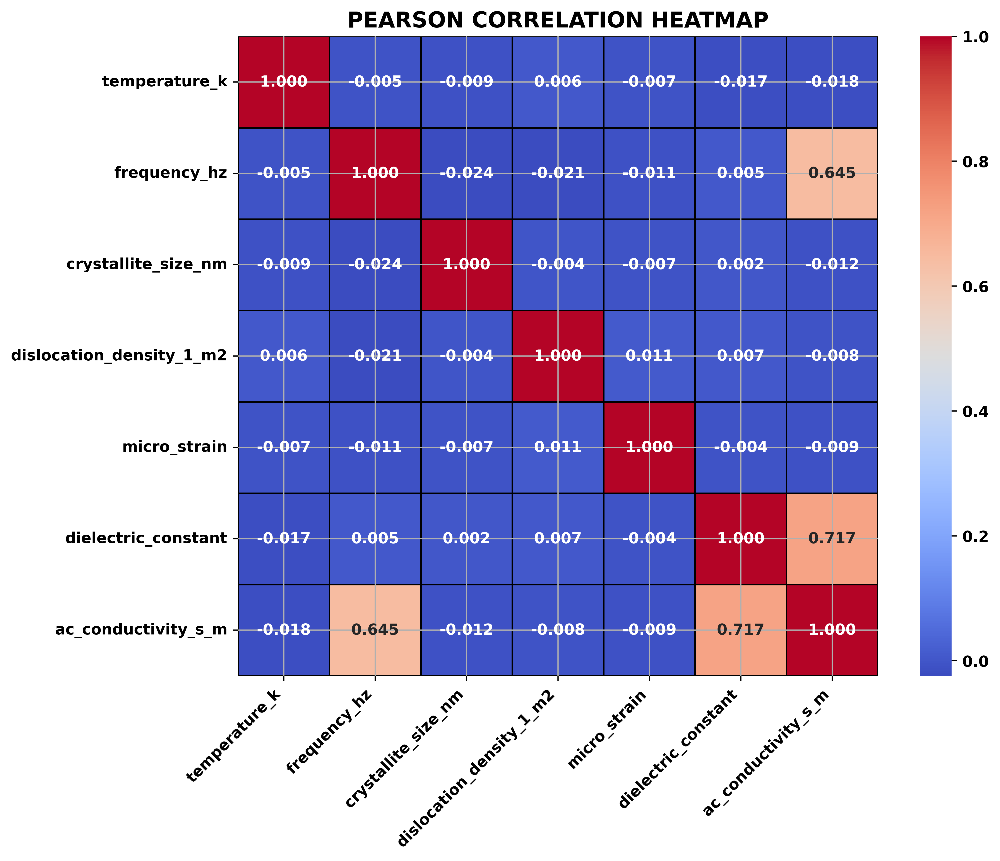

In [18]:
plot_correlation_heatmap(df_tlinte2)

### FEATURE VS TARGET SCATTER PLOT

In [19]:
def plot_feature_vs_target_scatter(df, target_col):
    """
    PLOTS SCATTER PLOTS FOR ALL INDEPENDENT FEATURES AGAINST THE TARGET VARIABLE.
    """
    features = [col for col in df.columns if col != target_col]
    fig, axes = plt.subplots(2, 3, figsize=(24, 12), dpi=500)
    axes = axes.flatten()
    
    for i, feature in enumerate(features):
        sns.scatterplot(data=df, x=feature, y=target_col, ax=axes[i], alpha=0.5, color='darkred')
        format_plot_axes(axes[i], title=f"{feature} VS {target_col}", xlabel=feature, ylabel=target_col)
        
    plt.tight_layout()
    plt.show()

In [20]:
plot_feature_vs_target_scatter(df_tlinte2, 'ac_conductivity_s_m')

## FEATURE RELATIONSHIP AND PHYSICS ANALYSIS

BASED ON THE CORRELATION MATRIX AND SCATTER PLOTS, WE CAN OBSERVE THE FOLLOWING MATHEMATICAL AND PHYSICAL RELATIONSHIPS:



1. **FREQUENCY DEPENDENCE**: THERE IS A STRONG POSITIVE CORRELATION BETWEEN FREQUENCY AND AC CONDUCTIVITY WHEN OTHER VARIABLES ARE HELD CONSTANT. THIS ALIGNS WITH THE CORRELATED BARRIER HOPPING (CBH) MODEL WHERE AC CONDUCTIVITY INCREASES WITH FREQUENCY OVER A BROAD RANGE.
2. **DIELECTRIC CONSTANT DEPENDENCE**: THE DIELECTRIC CONSTANT ALSO EXHIBITS A DIRECT PROPORTIONAL INFLUENCE ON CONDUCTIVITY, GOVERNED BY $\sigma_{ac} \propto \epsilon_r$. THE CORRELATION MATRIX CONFIRMS THIS STRONG RELATIONSHIP.
3. **STRUCTURAL PARAMETERS**: CRYSTALLITE SIZE, DISLOCATION DENSITY, AND MICRO STRAIN SHOW NEAR-ZERO CORRELATION WITH THE TARGET IN THIS SYNTHETIC GENERATION. WHILE THESE AFFECT DC CONDUCTIVITY AND SCATTERING EXPERIMENTALLY, THE PURE ANALYTICAL AC FORMULA ISOLATES THEM UNLESS $\epsilon_r$ OR $\tan(\delta)$ ARE TREATED AS EXPLICIT FUNCTIONS OF THESE STRUCTURAL DEFECTS.

## MODEL DEVELOPMENT (FROM BASIC TO ADVANCED)

IN THIS SECTION, WE SPLIT THE DATA, SCALE THE FEATURES, AND TRAIN A COMPREHENSIVE SUITE OF REGRESSION MODELS. THIS INCLUDES BASIC LINEAR ALGORITHMS (TO CAPTURE THE ANALYTICAL MATHEMATICAL FORMULA), SUPPORT VECTOR MACHINES, AND ADVANCED ENSEMBLE/TREE-BASED METHODS LIKE XGBOOST.

In [21]:
# IMPORT REQUIRED LIBRARIES FOR MODELING AND EVALUATION
import time
from sklearn.model_selection import train_test_split, learning_curve
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.dummy import DummyRegressor
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import (RandomForestRegressor, ExtraTreesRegressor, 
                              GradientBoostingRegressor, HistGradientBoostingRegressor)
from sklearn.neural_network import MLPRegressor
import xgboost as xgb
import shap

c:\PROJECTS\SEMICONDUCTOR AC CONDUCTIVITY\VENV\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### PREPARE THE DATASET

In [22]:
def prepare_data(df, target_col):
    """
    SPLITS THE DATAFRAME INTO TRAINING AND TESTING SETS, AND SCALES THE FEATURES.
    STANDARD SCALING IS CRITICAL FOR DISTANCE-BASED MODELS LIKE KNN AND SVR, 
    AND HELPS PREVENT GRADIENT EXPLOSION IN MLPS.
    """
    # EXTRACT FEATURES AND TARGET
    x = df.drop(columns=[target_col])
    y = df[target_col]
    
    # 80-20 TRAIN-TEST SPLIT
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)
    
    # APPLY STANDARD SCALER
    scaler = StandardScaler()
    x_train_scaled = scaler.fit_transform(x_train)
    x_test_scaled = scaler.transform(x_test)
    
    # CONVERT BACK TO DATAFRAME FOR FEATURE NAMES PRESERVATION
    x_train_scaled = pd.DataFrame(x_train_scaled, columns=x.columns)
    x_test_scaled = pd.DataFrame(x_test_scaled, columns=x.columns)
    
    return x_train_scaled, x_test_scaled, y_train, y_test

In [23]:
x_train, x_test, y_train, y_test = prepare_data(df_tlinte2, 'ac_conductivity_s_m')

### EXECUTE MODEL TRAINING PIPELINE

In [35]:
def train_and_evaluate_models(x_train, x_test, y_train, y_test):
    """
    TRAINS A FULL PIPELINE OF MACHINE LEARNING MODELS AND EVALUATES THEIR 
    PERFORMANCE USING STANDARD REGRESSION METRICS.
    """
    # INITIALIZE DICTIONARY OF MODELS TO TRAIN
    models = {
        'DUMMY REGRESSOR': DummyRegressor(strategy='mean'),
        'LINEAR REGRESSION': LinearRegression(),
        'RIDGE': Ridge(),
        'LASSO': Lasso(alpha=1e-8), # VERY SMALL ALPHA DUE TO TARGET SCALE (1E-6)
        'ELASTIC NET': ElasticNet(alpha=1e-8),
        'KNN': KNeighborsRegressor(n_neighbors=5),
        'DECISION TREE': DecisionTreeRegressor(random_state=42),
        'SVR (LINEAR)': SVR(kernel='linear'),
        'SVR (RBF)': SVR(kernel='rbf'),
        'RANDOM FOREST': RandomForestRegressor(n_estimators=100, random_state=42),
        'EXTRA TREES': ExtraTreesRegressor(n_estimators=100, random_state=42),
        'GRADIENT BOOSTING': GradientBoostingRegressor(random_state=42),
        'HIST GRADIENT BOOSTING': HistGradientBoostingRegressor(random_state=42),
        'XGBOOST': xgb.XGBRegressor(objective='reg:squarederror', random_state=42),
        'MLP (NEURAL NET)': MLPRegressor(hidden_layer_sizes=(64, 32), max_iter=500, random_state=42)
    }
    
    results = []
    trained_models = {}
    
    # ITERATE, TRAIN, AND EVALUATE EACH MODEL
    for name, model in models.items():
        start_time = time.time()
        
        # FIT THE MODEL TO THE TRAINING DATA
        model.fit(x_train, y_train)
        
        # PREDICT ON THE UNSEEN TEST SET
        y_pred = model.predict(x_test)
        
        # CALCULATE PERFORMANCE METRICS
        r2 = r2_score(y_test, y_pred)
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        mae = mean_absolute_error(y_test, y_pred)
        mse = mean_squared_error(y_test, y_pred)
        
        time_taken = time.time() - start_time
        
        # STORE METRICS
        results.append({
            'MODEL': name,
            'R2': r2,
            'RMSE': rmse,
            'MAE': mae,
            'MSE': mse,
            'TIME (S)': round(time_taken, 4)
        })
        
        # # STORE METRICS WITH ROUNDING TO 4 DECIMAL PLACES
        # results.append({
        #     'MODEL': name,
        #     'R2': round(r2, 4),
        #     'RMSE': round(rmse, 4),
        #     'MAE': round(mae, 4),
        #     'MSE': round(mse, 4),
        #     'TIME (S)': round(time_taken, 4)
        # })
        
        trained_models[name] = model
        
    results_df = pd.DataFrame(results).sort_values(by='R2', ascending=False).reset_index(drop=True)
    return results_df, trained_models

In [36]:
results_df, trained_models = train_and_evaluate_models(x_train, x_test, y_train, y_test)